# Dashboard

In [1]:
import pandas as pd 
from sklearn import preprocessing 
import matplotlib.pyplot as plt
from IPython.core import display as ICD
from sklearn.cluster import KMeans
from sklearn import metrics
from scipy.spatial.distance import cdist
import numpy as np
import matplotlib.pyplot as plt
from sklearn.preprocessing import MultiLabelBinarizer
from sklearn.metrics import pairwise_distances


In [115]:
import pandas as pd 
from sklearn import preprocessing 
import matplotlib.pyplot as plt
from IPython.core import display as ICD
from sklearn.cluster import KMeans
from sklearn import metrics
from scipy.spatial.distance import cdist
import numpy as np
import matplotlib.pyplot as plt
from sklearn.preprocessing import MultiLabelBinarizer
from sklearn.metrics import pairwise_distances

lb = MultiLabelBinarizer()
# Minimal distance threashold
threashold = 0.2
def extract_info(name):
    frequency,support,*group,other=name.split("-")
    return frequency,support,group[0][1:]+'-'+group[1][:-1]

files = !ls *groups.dat
group_stats = [] 
columns = ["file_name","frequency","support","group_size","nb_groups"]
for i in files :
    df = pd.read_csv(i,index_col=0)
    print(i,df.group.unique().shape,df.period.unique())
#     users = lb.fit_transform(df.users_ids.map(lambda x:[int(i) for i in x.split(",")]))
#     distances = pairwise_distances(users.astype(bool),metric='jaccard')
#     distances = pd.DataFrame(distances)
#     similarities = distances[(distances<threashold)&(distances>0)].stack().reset_index()
#     similarities.columns = ["group_x","group_y","value"]
#     similarities = similarities.merge(df,left_on="group_x",right_on="group")
#     ICD.display(similarities.period.unique())


3M-20-[2-100]-groups.dat (2702,) ['1996-08' '1996-11']
3M-20-[2-10]-groups.dat (2702,) ['1996-08' '1996-11']
3M-20-[2-20]-groups.dat (2702,) ['1996-08' '1996-11']
3M-20-[2-5]-groups.dat (2551,) ['1996-08' '1996-11']
3M-30-[2-100]-groups.dat (18,) ['1996-08']
3M-30-[2-10]-groups.dat (18,) ['1996-08']
3M-30-[2-20]-groups.dat (18,) ['1996-08']
3M-30-[2-5]-groups.dat (18,) ['1996-08']
6M-20-[2-100]-groups.dat (12725,) ['1996-08' '1997-02']
6M-20-[2-10]-groups.dat (12725,) ['1996-08' '1997-02']
6M-20-[2-20]-groups.dat (12725,) ['1996-08' '1997-02']
6M-20-[2-5]-groups.dat (10516,) ['1996-08' '1997-02']
6M-30-[2-100]-groups.dat (419,) ['1996-08' '1997-02']
6M-30-[2-10]-groups.dat (419,) ['1996-08' '1997-02']
6M-30-[2-20]-groups.dat (419,) ['1996-08' '1997-02']
6M-30-[2-5]-groups.dat (419,) ['1996-08' '1997-02']
Y-20-[2-100]-groups.dat (592811,) [1996 1997 2000 2015 2017]
Y-20-[2-10]-groups.dat (570440,) [1996 1997 2000 2015 2017]
Y-20-[2-20]-groups.dat (592811,) [1996 1997 2000 2015 2017]
Y-2

In [33]:
X = [[0, 1, 2],[3, 4, 5]]
pairwise_distances(X,X,metric="jaccard")

AttributeError: 'list' object has no attribute 'dtype'

Once deleted, variables cannot be recovered. Proceed (y/[n])? y


# DRAFT 

In [3]:
import numpy as np
from sklearn.metrics import jaccard_score
from sklearn.preprocessing import MultiLabelBinarizer
from sys import getsizeof
from sklearn.metrics import pairwise_distances
import numpy as np
import pandas as pd

lb = MultiLabelBinarizer()
# Minimal distance threashold
threashold = 0.2

In [4]:
df = pd.read_csv("Y-20-[2-10]-groups.dat",index_col=0)
df.period.unique()

array([1996, 1997, 2000, 2015, 2017])

In [5]:
users = lb.fit_transform(df.sort_values("group").users_ids.map(lambda x:[int(i) for i in x.split(",")])).astype(bool)

In [5]:
df.groupby(["period"]).group.count()

period
1996    570374
1997         6
2000        23
2015        33
2017         4
Name: group, dtype: int64

### Unifing similar groups 

In [6]:
from sklearn.metrics import pairwise_distances
prev = None
nb_split = 20
distances = []
for period,i in df.groupby("period"):
    for idx,ii in zip(np.array_split(i.index,nb_split),np.array_split(users[i.index],nb_split)):
        a = pairwise_distances(ii,metric="jaccard",n_jobs=-1)
        break
    break
#     pairwise_distances(users[i.index],metric="jaccard",n_jobs=-1)
#         distance = pd.DataFrame(distance)
#         distance = distance[distance<threashold]
        

In [7]:
a = pd.DataFrame(a,columns=idx,index=idx)
a.query("value>0.2")

UndefinedVariableError: name 'value' is not defined

In [ ]:
a[a<0.2]

MemoryError: Unable to allocate array with shape (813333361,) and data type bool

In [ ]:
mask = np.ones(users.shape[0],bool)
results = pd.DataFrame()
users = users.astype(bool)
for idx,i in df.groupby("period"):
    mask[i.index]=False
    try:
        a = pd.DataFrame(pairwise_distances(users[i.index],users[mask],metric="jaccard"))
        a.columns = df.index[mask]
        a.index = i.index
        a = a[a<1].stack().reset_index()
#         a = a[a<1].stack().reset_index()
        results = pd.concat([results,a],axis=0)
    except ValueError as e : #Exception for last period having no next 
        print(e)


In [20]:
df.group.size
# 592811 group

592811

In [21]:
a = lb.fit_transform(df.users_ids.map(lambda x : [int(i) for i in x.split(",")]))
a

array([[0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 1, 0],
       [0, 0, 0, ..., 0, 0, 0],
       ...,
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 1],
       [0, 0, 0, ..., 0, 0, 0]])

In [47]:
X
[np.flatnonzero(d < r) for d in D_chunk]

[array([0, 3]), array([1]), array([2]), array([0, 3]), array([4])]

In [12]:
import numpy as np
from sklearn.metrics import pairwise_distances_chunked
def reduce_func(D_chunk, start):
    print(start)
    return D_chunk
gen = pairwise_distances_chunked(users, reduce_func=reduce_func,metric="jaccard")

In [13]:
for i in gen:
    break

/home/abdelwahab/.virtualenvs/3env/local/lib/python3.7/site-packages/sklearn/metrics/pairwise.py:1575: DataConversionWarning: Data was converted to boolean for metric jaccard
  warnings.warn(msg, DataConversionWarning)


0


In [40]:
from sklearn.metrics import pairwise_distances_chunked


In [335]:
prev = None
for period,i in pd.DataFrame(a).join(df.period).groupby("period"):
    if prev is None:
        prev = i
        continue
    pass

In [16]:
a = np.array([[0,1,1,1],[1,1,2,3]])
b = np.array([[1,0,0,0],[0,1,1,2]])
prod = a*b
print(prod)
prod.sum()
np.prod(a,b)

[[0 0 0 0]
 [0 1 2 6]]


TypeError: only integer scalar arrays can be converted to a scalar index

# Compute distance 

#### Apply MultilabelBinarizer, and add period and group for each row

In [10]:
users = lb.fit_transform(df.users_ids.map(lambda x:[int(i) for i in x.split(",")]))
a = pd.DataFrame(users).reset_index().merge(df[["period","group"]],left_on="index",right_on="group")
a.drop(["group","index"],axis=1,inplace=True)

users = users.astype(bool)

#### Compute distance of each group from period[i] with all groups having period[j] j>i 

In [11]:
mask = np.ones(users.shape[0],bool)
results = pd.DataFrame()
users = users.astype(bool)
for idx,i in df.groupby("period"):
    mask[i.index]=False
    try:
        a = pd.DataFrame(pairwise_distances(users[i.index],users[mask],metric="jaccard"))
        a.columns = df.index[mask]
        a.index = i.index
        a = a[a<1].stack().reset_index()
#         a = a[a<1].stack().reset_index()
        results = pd.concat([results,a],axis=0)
    except ValueError as e : #Exception for last period having no next 
        print(e)


Found array with 0 sample(s) (shape=(0, 239)) while a minimum of 1 is required by check_pairwise_arrays.


In [15]:
a = results[results[0]<1]
a

,level_0,level_1,0
0,0.0,91696.0,0.978495
1,0.0,91697.0,0.989130
2,0.0,91698.0,0.989011
3,0.0,91699.0,0.989011
4,0.0,91700.0,0.989011
5,0.0,91701.0,0.977778
6,1.0,91696.0,0.977778
7,1.0,91697.0,0.988764
8,1.0,91698.0,0.988636
9,1.0,91699.0,0.988636


In [258]:
results.columns = ["group","group_y","value"]
stats = results.astype(int).merge(df[["users_ids","group"]],left_on="group",right_on="group").merge(df[["users_ids","group"]],left_on="group_y",right_on="group")
stats["users_ids_x"].apply(lambda x:print([int(i) for i in x)]))

SyntaxError: invalid syntax (<ipython-input-258-2190ae7d02e9>, line 3)

### Compute distances matrix: 
1. MultilabelBinarizer
2. Pairwise distances using Jaccard distance  as a metric

In [3]:
users = lb.fit_transform(df.users_ids.map(lambda x:[int(i) for i in x.split(",")]))
distances = pairwise_distances(users,metric='jaccard')
distances = pd.DataFrame(distances)
distances.head()

/home/abdelwahab/.virtualenvs/3env/local/lib/python3.7/site-packages/sklearn/metrics/pairwise.py:1575: DataConversionWarning: Data was converted to boolean for metric jaccard
  warnings.warn(msg, DataConversionWarning)


MemoryError: Unable to allocate array with shape (175712144455,) and data type float64

In [54]:
# Minimal distance threashold
threashold = 0.2

In [55]:
similarities = distances[(distances<threashold)&(distances>0)].stack().reset_index()
similarities
similarities.columns = ["group_x","group_y","value"]
similarities = similarities.merge(df,left_on="group_x",right_on="group")
similarities.period.unique()

array([1996])

In [ ]:
import plotly.graph_objects as go

fig = go.Figure(data=[go.Sankey(
    node = dict(
      pad = 10,
      thickness = 20,
      line = dict(color = "black", width = 0.5),
      label = similarities.group_x.tolist(),
      color = "blue"
    ),
    link = dict(
      source = similarities.group_x.tolist(), # indices correspond to labels, eg A1, A2, A2, B1, ...
      target = similarities.group_y.tolist(),
      value = similarities.value.tolist()
  ))])

fig.update_layout(title_text="Basic Sankey Diagram", font_size=10)
fig.show()

In [117]:
df.users_ids.str.split(",",expand=True).dropna()

,0,1,2,3,4,5,6,7,8,9,...,62,63,64,65,66,67,68,69,70,71
0,5,6,8,26,37,38,40,43,46,56,...,559,565,566,569,574,584,588,592,602,604


In [28]:
df[(df.group==0)|(df.group==3)]

,period,itemset,support,users_ids,group
48,1996,344 296,60,"5,6,14,26,37,40,43,56,58,81,94,99,102,107,109,...",3
132,1996,153 344,57,"5,6,14,26,37,40,43,46,56,58,81,94,99,102,107,1...",0


In [12]:
import plotly.graph_objects as go

fig = go.Figure(data=[go.Sankey(
    node = dict(
      pad = 10,
      thickness = 20,
      line = dict(color = "black", width = 0.5),
      label = similarities_in_groups.group_id_x.tolist(),
      color = "blue"
    ),
    link = dict(
      source = similarities_in_groups.group_id_x.tolist(), # indices correspond to labels, eg A1, A2, A2, B1, ...
      target = similarities_in_groups.group_id_y.tolist(),
      value = similarities_in_groups.period_x.tolist()
  ))])

fig.update_layout(title_text="Basic Sankey Diagram", font_size=10)
fig.show()

AttributeError: 'DataFrame' object has no attribute 'tolist'

In [73]:
df[df.group_id==3]

,user_id,group_id,period
2464,1,3,2000
2465,160,3,2000
2466,267,3,2000
2467,414,3,2000
2468,591,3,2000


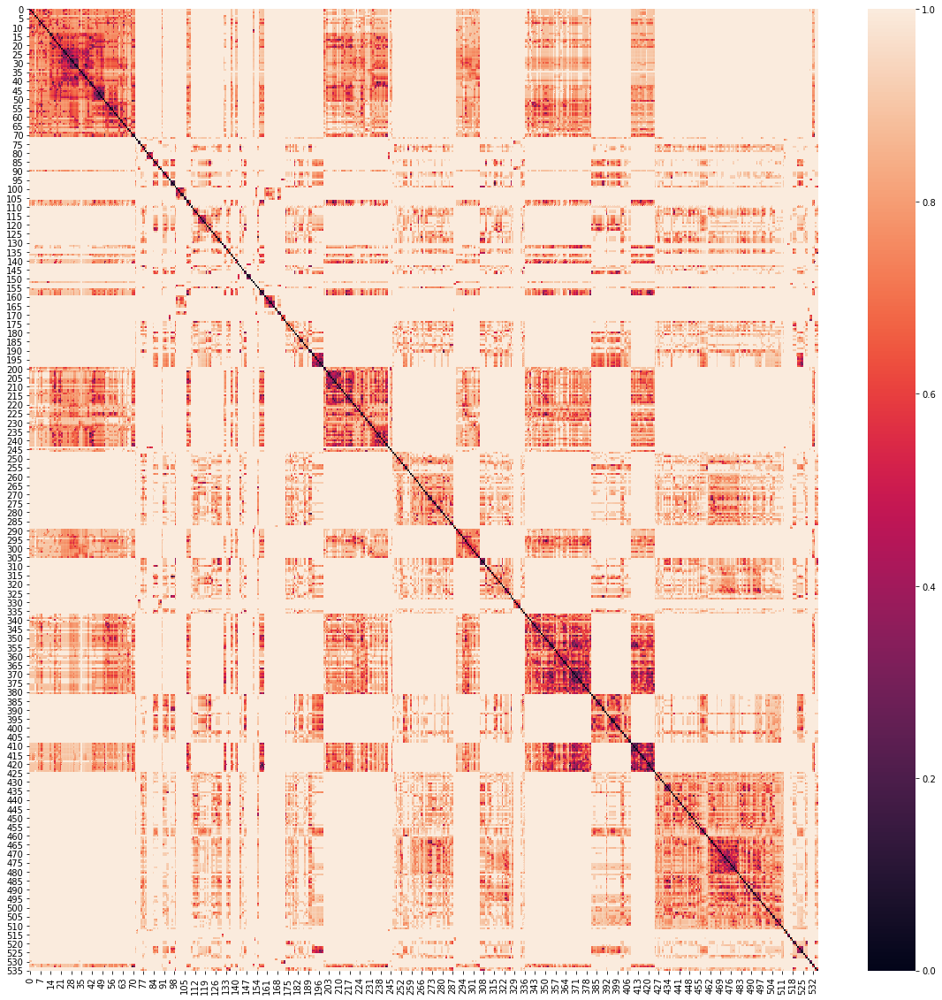

In [289]:
a = pd.DataFrame(comparison_result)
import seaborn as sns 
f, ax = plt.subplots(figsize=(20, 20))
# corr =bank.corr()
sns.heatmap(a)

In [13]:
periods = groups_details.period.unique()
results = []
for (period,group_id),i in groups_details.groupby(["period","group_id"]):
    try:
        next_period = periods[periods>period][0]
    except:
        continue
    groups_to_compare = users[groups_details[groups_details.period==next_period]["group_id"].index]
    size = groups_to_compare.shape[0]
    
    group_to_compare = np.repeat([users[group_id]],size,axis=1)
    
    comparison_result = pairwise_distances(group_to_compare,group_to_compare,metric='jaccard')
    results.append((group_id,comparison_result))
period = 2016
results
# users

/home/abdelwahab/.virtualenvs/3env/local/lib/python3.7/site-packages/sklearn/metrics/pairwise.py:1575: DataConversionWarning: Data was converted to boolean for metric jaccard
  warnings.warn(msg, DataConversionWarning)
/home/abdelwahab/.virtualenvs/3env/local/lib/python3.7/site-packages/sklearn/metrics/pairwise.py:1575: DataConversionWarning: Data was converted to boolean for metric jaccard
  warnings.warn(msg, DataConversionWarning)
/home/abdelwahab/.virtualenvs/3env/local/lib/python3.7/site-packages/sklearn/metrics/pairwise.py:1575: DataConversionWarning: Data was converted to boolean for metric jaccard
  warnings.warn(msg, DataConversionWarning)
/home/abdelwahab/.virtualenvs/3env/local/lib/python3.7/site-packages/sklearn/metrics/pairwise.py:1575: DataConversionWarning: Data was converted to boolean for metric jaccard
  warnings.warn(msg, DataConversionWarning)
/home/abdelwahab/.virtualenvs/3env/local/lib/python3.7/site-packages/sklearn/metrics/pairwise.py:1575: DataConversionWarning

/home/abdelwahab/.virtualenvs/3env/local/lib/python3.7/site-packages/sklearn/metrics/pairwise.py:1575: DataConversionWarning: Data was converted to boolean for metric jaccard
  warnings.warn(msg, DataConversionWarning)
/home/abdelwahab/.virtualenvs/3env/local/lib/python3.7/site-packages/sklearn/metrics/pairwise.py:1575: DataConversionWarning: Data was converted to boolean for metric jaccard
  warnings.warn(msg, DataConversionWarning)
/home/abdelwahab/.virtualenvs/3env/local/lib/python3.7/site-packages/sklearn/metrics/pairwise.py:1575: DataConversionWarning: Data was converted to boolean for metric jaccard
  warnings.warn(msg, DataConversionWarning)
/home/abdelwahab/.virtualenvs/3env/local/lib/python3.7/site-packages/sklearn/metrics/pairwise.py:1575: DataConversionWarning: Data was converted to boolean for metric jaccard
  warnings.warn(msg, DataConversionWarning)
/home/abdelwahab/.virtualenvs/3env/local/lib/python3.7/site-packages/sklearn/metrics/pairwise.py:1575: DataConversionWarning

/home/abdelwahab/.virtualenvs/3env/local/lib/python3.7/site-packages/sklearn/metrics/pairwise.py:1575: DataConversionWarning: Data was converted to boolean for metric jaccard
  warnings.warn(msg, DataConversionWarning)
/home/abdelwahab/.virtualenvs/3env/local/lib/python3.7/site-packages/sklearn/metrics/pairwise.py:1575: DataConversionWarning: Data was converted to boolean for metric jaccard
  warnings.warn(msg, DataConversionWarning)
/home/abdelwahab/.virtualenvs/3env/local/lib/python3.7/site-packages/sklearn/metrics/pairwise.py:1575: DataConversionWarning: Data was converted to boolean for metric jaccard
  warnings.warn(msg, DataConversionWarning)
/home/abdelwahab/.virtualenvs/3env/local/lib/python3.7/site-packages/sklearn/metrics/pairwise.py:1575: DataConversionWarning: Data was converted to boolean for metric jaccard
  warnings.warn(msg, DataConversionWarning)
/home/abdelwahab/.virtualenvs/3env/local/lib/python3.7/site-packages/sklearn/metrics/pairwise.py:1575: DataConversionWarning

[(72, array([[0.]])),
 (76, array([[0.]])),
 (77, array([[0.]])),
 (78, array([[0.]])),
 (79, array([[0.]])),
 (84, array([[0.]])),
 (85, array([[0.]])),
 (86, array([[0.]])),
 (87, array([[0.]])),
 (91, array([[0.]])),
 (92, array([[0.]])),
 (93, array([[0.]])),
 (94, array([[0.]])),
 (96, array([[0.]])),
 (97, array([[0.]])),
 (98, array([[0.]])),
 (99, array([[0.]])),
 (110, array([[0.]])),
 (111, array([[0.]])),
 (112, array([[0.]])),
 (113, array([[0.]])),
 (114, array([[0.]])),
 (115, array([[0.]])),
 (116, array([[0.]])),
 (117, array([[0.]])),
 (118, array([[0.]])),
 (119, array([[0.]])),
 (120, array([[0.]])),
 (121, array([[0.]])),
 (122, array([[0.]])),
 (123, array([[0.]])),
 (124, array([[0.]])),
 (125, array([[0.]])),
 (126, array([[0.]])),
 (127, array([[0.]])),
 (128, array([[0.]])),
 (129, array([[0.]])),
 (130, array([[0.]])),
 (134, array([[0.]])),
 (135, array([[0.]])),
 (136, array([[0.]])),
 (143, array([[0.]])),
 (144, array([[0.]])),
 (145, array([[0.]])),
 (146

In [7]:
groups_details = df.groupby(["period","group_id"])["user_id"].apply(lambda x: [z for z in x ] ).reset_index(name="users")
a = groups_details.users[0]
# groups_details.groupby(["period","users","group_id"])["users"].to_frame()
for i in groups_details.loc[df.group_id.drop_duplicates().reindex()]:
#     a = [int(z) for z in i["users"].split(" ")]
    print(i)
#     pass
# groups_details.group_id.nunique()
# c = b.copy()
# for i in range(100):
#     c[0][i]=1
# print(jaccard_score([],c,average=None))
# b
groups_details.group_id.value_counts()
users = groups_details.groupby("group_id").first().reset_index()["users"]
# b = pd.DataFrame(data=lb.fit_transform(a.users))
print(jaccard_score(users,users,average=None))


period
group_id
users


NameError: name 'jaccard_score' is not defined

In [333]:
from scipy.sparse import lil_matrix
def label_to_sm(labels, n_classes):
    sm = lil_matrix((len(labels), n_classes))
    for i, label in enumerate(labels):
        sm[i, label] = 1
    return sm
label_to_sm(users[0],1000).toarray()

array([[0., 1., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.]])

In [259]:
from sklearn.preprocessing import MultiLabelBinarizer
lb = preprocessing.MultiLabelBinarizer()
a = df.groupby(["period","group_id"])["user_id"].apply(lambda x: [z for z in x]).reset_index(name="users")
b = pd.DataFrame(data=lb.fit_transform(a.users))
# a["users"].value_counts(ascending=True)
# ICD.display(df.groupby(["group_id"]).user_id.count().reset_index(name="nb_users").groupby('nb_users').group_id.count().reset_index(name="nb_groups").sum())
b

,0,1,2,3,4,5,6,7,8,9,...,224,225,226,227,228,229,230,231,232,233
0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,0,0,0,0,0,0,0,0,0,0,...,1,0,0,0,0,0,0,0,0,0
3,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
5,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,1,0,0,0,0,0
6,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,1,0,0,0,0,0
7,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,1,0,0,0,0,0
8,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,1,0,0,0,0,0
9,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,1,0,0,0,0,0


In [161]:
from sklearn.cluster import KMeans

# kmeans = KMeans(n_clusters=100)
# kmeans.fit(b)
# labels = kmeans.predict(b)
# a["clusters"] = labels
# a["clusters"].value_counts().reset_index(name="count_values")
# k means determine k
# X=b
# distortions = []
# K = range(10,100)
# for k in K:
#     kmeanModel = KMeans(n_clusters=k).fit(X)
#     kmeanModel.fit(X)
#     distortions.append(sum(np.min(cdist(X, kmeanModel.cluster_centers_, 'euclidean'), axis=1)) / X.shape[0])
# La moyenne du nombre d'utilisateur/groupe 
ICD.display(df.groupby(["group_id"]).user_id.count().reset_index(name="nb_users").groupby('nb_users').group_id.count().reset_index(name="nb_groups").sum())
# plt.hist(df.groupby(["period","group_id"]).user_id.count())
# nb_users     135
# nb_groups    536


nb_users     135
nb_groups    536
dtype: int64

5.999999999999999

In [75]:
group_stats[group_stats.dataset_filter=="rating>4"].sort_values(["frequency","support"],ascending=False)

,file_name,frequency,support,group_size,dataset_filter,nb_groups,nb_users,rank
290,results/Y-5-[2-5]-rating>4-groups.dat,Y,5,2-5,rating>4,944,373,2.530831
275,results/Y-5-[2-100]-rating>4-groups.dat,Y,5,2-100,rating>4,951,373,2.549598
280,results/Y-5-[2-10]-rating>4-groups.dat,Y,5,2-10,rating>4,951,373,2.549598
285,results/Y-5-[2-20]-rating>4-groups.dat,Y,5,2-20,rating>4,951,373,2.549598
241,results/Y-2-[20-50]-rating>4-groups.dat,Y,2,20-50,rating>4,78,65,1.200000
265,results/Y-2-[2-5]-rating>4-groups.dat,Y,2,2-5,rating>4,6166,551,11.190563
247,results/Y-2-[2-100]-rating>4-groups.dat,Y,2,2-100,rating>4,6166,551,11.190563
253,results/Y-2-[2-10]-rating>4-groups.dat,Y,2,2-10,rating>4,7286,551,13.223230
259,results/Y-2-[2-20]-rating>4-groups.dat,Y,2,2-20,rating>4,7582,551,13.760436
220,results/Y-15-[2-10]-rating>4-groups.dat,Y,15,2-10,rating>4,3,31,0.096774


In [8]:
def extract_info(name):
    frequency,support,*group,dataset_filter,other=name.split("-")
    frequency = frequency.split("/")[1]
    return frequency,support,group[0][1:]+'-'+group[1][:-1],dataset_filter

files = !ls *groups.dat
group_stats = [] 
columns = ["file_name","frequency","support","group_size","dataset_filter","nb_groups","nb_users"]
for i in files :
    df = pd.read_csv(i,index_col=0)
    nb_users,nb_groups = df[["users_ids","group"]].nunique()
    user_per_group = df.groupby(["group"]).users_ids.count().reset_index(name="nb_users").groupby('nb_users').group.count().reset_index(name="nb_groups")
    group_stats.append((i,*extract_info(i),nb_groups,nb_users))
group_stats = pd.DataFrame(group_stats,columns=columns).sort_values("nb_groups")
ICD.display(group_stats.head(40))
ICD.display(group_stats.tail(10))

IndexError: list index out of range

In [71]:
group_stats["rank"] = group_stats.nb_groups/group_stats.nb_users
group_stats.sort_values("rank",ascending=False)

,file_name,frequency,support,group_size,dataset_filter,nb_groups,nb_users,rank
258,results/Y-2-[2-20]-rating>3-groups.dat,Y,2,2-20,rating>3,100081,605,165.423140
252,results/Y-2-[2-10]-rating>3-groups.dat,Y,2,2-10,rating>3,91515,605,151.264463
274,results/Y-5-[2-100]-rating>3-groups.dat,Y,5,2-100,rating>3,53905,548,98.366788
284,results/Y-5-[2-20]-rating>3-groups.dat,Y,5,2-20,rating>3,53743,548,98.071168
279,results/Y-5-[2-10]-rating>3-groups.dat,Y,5,2-10,rating>3,52423,548,95.662409
246,results/Y-2-[2-100]-rating>3-groups.dat,Y,2,2-100,rating>3,55753,605,92.153719
264,results/Y-2-[2-5]-rating>3-groups.dat,Y,2,2-5,rating>3,55753,605,92.153719
289,results/Y-5-[2-5]-rating>3-groups.dat,Y,5,2-5,rating>3,37728,548,68.846715
109,results/6M-2-[2-100]-rating>3-groups.dat,6M,2,2-100,rating>3,33071,597,55.395310
121,results/6M-2-[2-20]-rating>3-groups.dat,6M,2,2-20,rating>3,32137,597,53.830821


In [33]:
# Import Data
df = pd.read_csv("https://raw.githubusercontent.com/selva86/datasets/master/mpg_ggplot2.csv")
df_counts = df.groupby(['hwy', 'cty']).size().reset_index(name='counts')

# Draw Stripplot
fig, ax = plt.subplots(figsize=(16,10), dpi= 80)    
sns.stripplot(df_counts.cty, df_counts.hwy, size=df_counts.counts*2, ax=ax)

# Decorations
plt.title('Counts Plot - Size of circle is bigger as more points overlap', fontsize=22)
plt.show()

['3M-10-[2-100]-2<rating<4-groups.dat',
 '3M-10-[2-100]-rating>3-groups.dat',
 '3M-10-[2-100]-rating>4-groups.dat',
 '3M-10-[2-100]-rating==5-groups.dat',
 '3M-15-[2-100]-rating>3-groups.dat',
 '3M-20-[2-100]-rating>3-groups.dat',
 '3M-2-[2-100]-2<rating<4-groups.dat',
 '3M-2-[2-100]-rating<2-groups.dat',
 '3M-2-[2-100]-rating<3-groups.dat',
 '3M-2-[2-100]-rating>3-groups.dat',
 '3M-2-[2-100]-rating>4-groups.dat',
 '3M-2-[2-100]-rating==5-groups.dat',
 '3M-5-[2-100]-2<rating<4-groups.dat',
 '3M-5-[2-100]-rating<3-groups.dat',
 '3M-5-[2-100]-rating>3-groups.dat',
 '3M-5-[2-100]-rating>4-groups.dat',
 '3M-5-[2-100]-rating==5-groups.dat',
 '6M-10-[2-100]-2<rating<4-groups.dat',
 '6M-10-[2-100]-rating>3-groups.dat',
 '6M-10-[2-100]-rating>4-groups.dat',
 '6M-10-[2-100]-rating==5-groups.dat',
 '6M-15-[2-100]-2<rating<4-groups.dat',
 '6M-15-[2-100]-rating>3-groups.dat',
 '6M-20-[2-100]-rating>3-groups.dat',
 '6M-2-[2-100]-2<rating<4-groups.dat',
 '6M-2-[2-100]-rating<2-groups.dat',
 '6M-2-[2

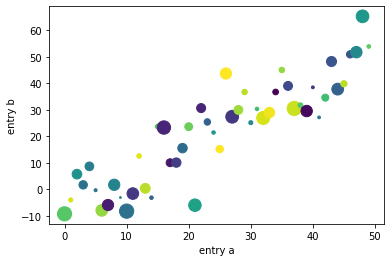

In [9]:
import numpy as np 
data = {'a': np.arange(50),
        'c': np.random.randint(0, 50, 50),
        'd': np.random.randn(50)}
data['b'] = data['a'] + 10 * np.random.randn(50)
data['d'] = np.abs(data['d']) * 100

plt.scatter('a', 'b', c='c', s='d', data=data)
plt.xlabel('entry a')
plt.ylabel('entry b')
plt.show()

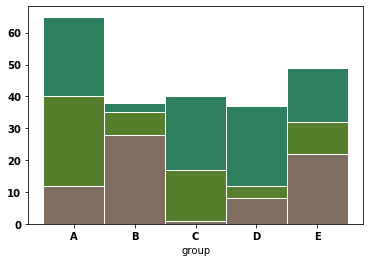

In [20]:
# libraries
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import rc
import pandas as pd
 
# y-axis in bold
rc('font', weight='bold')
 
# Values of each group
bars1 = [12, 28, 1, 8, 22]
bars2 = [28, 7, 16, 4, 10]
bars3 = [25, 3, 23, 25, 17]
 
# Heights of bars1 + bars2
bars = np.add(bars1, bars2).tolist()
 
# The position of the bars on the x-axis
r = [0,1,2,3,4]
 
# Names of group and bar width
names = ['A','B','C','D','E']
barWidth = 1
 
# Create brown bars
plt.bar(r, bars1, color='#7f6d5f', edgecolor='white', width=barWidth)
# Create green bars (middle), on top of the firs ones
plt.bar(r, bars2, bottom=bars1, color='#557f2d', edgecolor='white', width=barWidth)
# Create green bars (top)
plt.bar(r, bars3, bottom=bars, color='#2d7f5e', edgecolor='white', width=barWidth)
 
# Custom X axis
plt.xticks(r, names, fontweight='bold')
plt.xlabel("group")
 
# Show graphic
plt.show()


In [44]:
import seaborn as sns
sns.set()
df.set_index('App').T.plot(kind='bar', stacked=True)

KeyError: 'App'

In [46]:
import pandas as pd
from matplotlib import pyplot as plt
import matplotlib as mpl
import seaborn as sns
%matplotlib inline

#Read in data & create total column
stacked_bar_data = pd.read_csv("C:\stacked_bar.csv")
stacked_bar_data["total"] = stacked_bar_data.Series1 + stacked_bar_data.Series2

#Set general plot properties
sns.set_style("white")
sns.set_context({"figure.figsize": (24, 10)})

#Plot 1 - background - "total" (top) series
sns.barplot(x = stacked_bar_data.Group, y = stacked_bar_data.total, color = "red")

#Plot 2 - overlay - "bottom" series
bottom_plot = sns.barplot(x = stacked_bar_data.Group, y = stacked_bar_data.Series1, color = "#0000A3")


topbar = plt.Rectangle((0,0),1,1,fc="red", edgecolor = 'none')
bottombar = plt.Rectangle((0,0),1,1,fc='#0000A3',  edgecolor = 'none')
l = plt.legend([bottombar, topbar], ['Bottom Bar', 'Top Bar'], loc=1, ncol = 2, prop={'size':16})
l.draw_frame(False)

#Optional code - Make plot look nicer
sns.despine(left=True)
bottom_plot.set_ylabel("Y-axis label")
bottom_plot.set_xlabel("X-axis label")

#Set fonts to consistent 16pt size
for item in ([bottom_plot.xaxis.label, bottom_plot.yaxis.label] +
             bottom_plot.get_xticklabels() + bottom_plot.get_yticklabels()):
    item.set_fontsize(16)

FileNotFoundError: File b'C:\\stacked_bar.csv' does not exist

In [181]:
# a = !ls *.dat
# for i in a:
#     df = pd.read_csv(i)
#     try:
#             print(df.group_id.count(),'||||||||||||',i)
#     except:
#         pass
df = pd.read_csv("Y-15-[2-100]-rating==5-groups.dat")
df

,Unnamed: 0,user_id,group_id,period
0,0,6,2,1996
1,1,38,2,1996
2,2,58,2,1996
3,3,94,2,1996
4,4,107,2,1996
5,5,109,2,1996
6,6,117,2,1996
7,7,130,2,1996
8,8,176,2,1996
9,9,179,2,1996


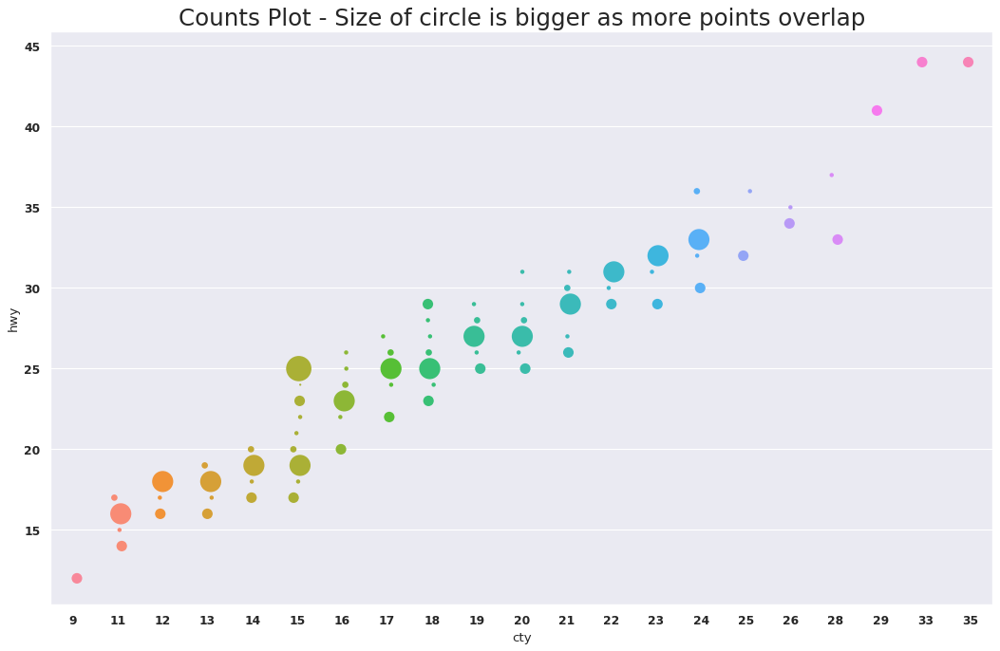

In [151]:
# Import Data
df = pd.read_csv("https://raw.githubusercontent.com/selva86/datasets/master/mpg_ggplot2.csv")
df_counts = df.groupby(['hwy', 'cty']).size().reset_index(name='counts')

# Draw Stripplot
fig, ax = plt.subplots(figsize=(16,10), dpi= 80)    
sns.stripplot(df_counts.cty, df_counts.hwy, size=df_counts.counts*2, ax=ax)

# Decorations
plt.title('Counts Plot - Size of circle is bigger as more points overlap', fontsize=22)
plt.show()

In [160]:
df.groupby(['hwy', 'cty']).size().reset_index(name='counts').head()

,hwy,cty,counts
0,12,9,5
1,14,11,2
2,15,11,10
3,16,11,3
4,16,12,2


In [161]:
df.head()

,manufacturer,model,displ,year,cyl,trans,drv,cty,hwy,fl,class
0,audi,a4,1.8,1999,4,auto(l5),f,18,29,p,compact
1,audi,a4,1.8,1999,4,manual(m5),f,21,29,p,compact
2,audi,a4,2.0,2008,4,manual(m6),f,20,31,p,compact
3,audi,a4,2.0,2008,4,auto(av),f,21,30,p,compact
4,audi,a4,2.8,1999,6,auto(l5),f,16,26,p,compact


In [456]:
import requests, json
!pip install plotly
import plotly.graph_objects as go

url = 'https://raw.githubusercontent.com/plotly/plotly.js/master/test/image/mocks/sankey_energy.json'
data = requests.get(url).json()

     |████████████████████████████████| 7.2MB 99kB/s eta 0:00:014


In [458]:
data

{'data': [{'type': 'sankey',
   'domain': {'x': [0, 1], 'y': [0, 1]},
   'orientation': 'h',
   'valueformat': '.0f',
   'valuesuffix': 'TWh',
   'node': {'pad': 15,
    'thickness': 15,
    'line': {'color': 'black', 'width': 0.5},
    'label': ["Agricultural 'waste'",
     'Bio-conversion',
     'Liquid',
     'Losses',
     'Solid',
     'Gas',
     'Biofuel imports',
     'Biomass imports',
     'Coal imports',
     'Coal',
     'Coal reserves',
     'District heating',
     'Industry',
     'Heating and cooling - commercial',
     'Heating and cooling - homes',
     'Electricity grid',
     'Over generation / exports',
     'H2 conversion',
     'Road transport',
     'Agriculture',
     'Rail transport',
     'Lighting & appliances - commercial',
     'Lighting & appliances - homes',
     'Gas imports',
     'Ngas',
     'Gas reserves',
     'Thermal generation',
     'Geothermal',
     'H2',
     'Hydro',
     'International shipping',
     'Domestic aviation',
     'Internation

In [18]:
import plotly.graph_objects as go

fig = go.Figure(data=[go.Sankey(
    node = dict(
      pad = 1,
      thickness = 1,
      line = dict(color = "black", width = 0.5),
      label = df.group,
      color = "blue"
    ),
    link = dict(
      source = a.level_0, # indices correspond to labels, eg A1, A2, A2, B1, ...
      target = a.level_1,
      value = a[0]
  ))])

fig.update_layout(title_text="Basic Sankey Diagram", font_size=1)
fig.show()

In [478]:
# imports
import pandas as pd
import numpy as np
import plotly.graph_objs as go
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
init_notebook_mode(connected=True)

# Nodes & links
nodes = [['ID', 'Label', 'Color'],
        [0,'AKJ Education','#4994CE'],
        [1,'Amazon','#8A5988'],
        [2,'Flipkart','#449E9E'],
        [3,'Books','#7FC241'],
        [4,'Computers & tablets','#D3D3D3'],
        [5,'Other','#4994CE'],]

# links with your data
links = [['Source','Target','Value','Link Color'],

        # AKJ
        [0,3,1,'rgba(127, 194, 65, 0.2)'],
        [0,4,1,'rgba(127, 194, 65, 0.2)'],

        # Amazon
        [1,3,1,'rgba(211, 211, 211, 0.5)'],
        [1,4,1,'rgba(211, 211, 211, 0.5)'],
        [1,5,1,'rgba(211, 211, 211, 0.5)'],

        # Flipkart
        [2,5,1,'rgba(253, 227, 212, 1)'],
        [2,3,1,'rgba(253, 227, 212, 1)'],]


# Retrieve headers and build dataframes
nodes_headers = nodes.pop(0)
links_headers = links.pop(0)
df_nodes = pd.DataFrame(nodes, columns = nodes_headers)
df_links = pd.DataFrame(links, columns = links_headers)

# Sankey plot setup
data_trace = dict(
    type='sankey',
    domain = dict(
      x =  [0,1],
      y =  [0,1]
    ),
    orientation = "h",
    valueformat = ".0f",
    node = dict(
      pad = 10,
    # thickness = 30,
      line = dict(
        color = "black",
        width = 0
      ),
      label =  df_nodes['Label'].dropna(axis=0, how='any'),
      color = df_nodes['Color']
    ),
    link = dict(
      source = df_links['Source'].dropna(axis=0, how='any'),
      target = df_links['Target'].dropna(axis=0, how='any'),
      value = df_links['Value'].dropna(axis=0, how='any'),
      color = df_links['Link Color'].dropna(axis=0, how='any'),
  )
)

layout = dict(
        title = "Draw Sankey Diagram from dataframes",
    height = 772,
    font = dict(
      size = 10),)

fig = dict(data=[data_trace], layout=layout)
iplot(fig, validate=False)